In [3]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import time
import numpy as np
import cv2

%matplotlib inline

In [11]:
import os

def loadImages(folder):
    imgs = []
    for _i, img_name in enumerate(sorted(os.listdir(folder))):
        if _i % 8 == 0:
            if img_name.endswith(".JPG"):
                img_path = os.path.join(folder, img_name)
                
                img = cv2.imread(img_path)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)    # BGR -> gray
                img = cv2.resize(img, dsize=(800,1000))
                img = img.astype(np.float64)    # uint8 -> float
                img /= 255.    # [0, 255] -> [0, 1]
                imgs.append(img)
        
    return imgs

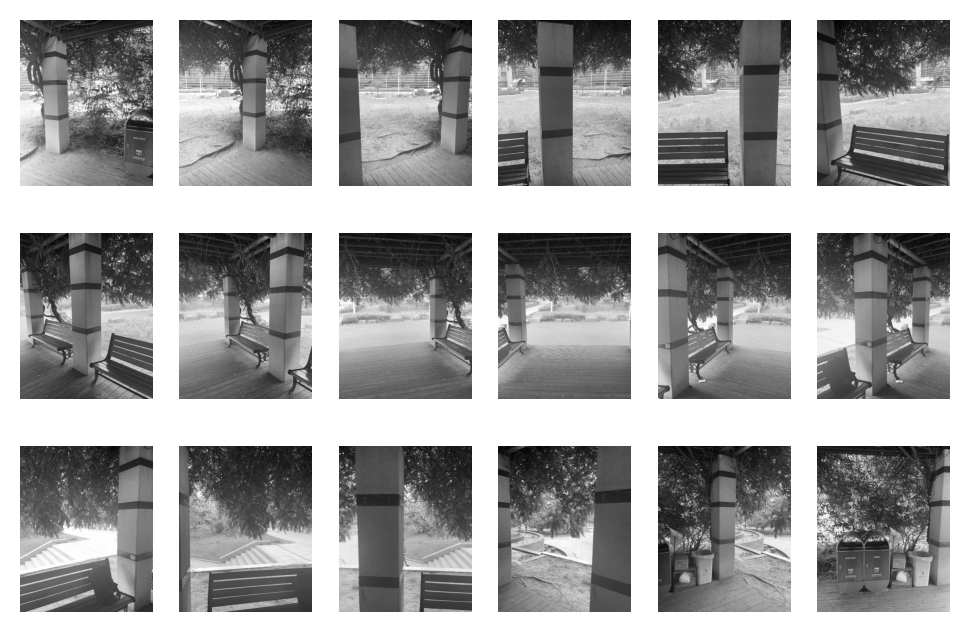

In [12]:
imgs = loadImages("./image_folder")
fig = plt.figure(dpi=200)
plt.tight_layout()
for i, img in enumerate(imgs):
    plt.subplot(3, 6, i+1)
    plt.axis("off")
    plt.imshow(img, cmap="gray")
plt.show()

In [13]:
# Define Filter function for sobel filtering
def filter(weights, roi):
    # these two lines are important as they ensure correct
    # computations!
    weights = weights.astype(float)    # convert correctly
    roi = roi.astype(float)            # convert correctly
    # this holds the end result
    filtered = np.zeros_like(roi)
    width = int((weights.shape[1]-1)/2)
    height = int((weights.shape[0]-1)/2)
    # do the filtering
    for i in range(height,roi.shape[1]-height):
        for j in range(width,roi.shape[0]-width):
            filtered[j,i] = (weights * roi[j-width:j+width+1, i-height:i+height+1]).sum()       # how do you create the output of the filtering?
    
    return filtered

# To select local maximum
def non_local_maximum_suppression(values, winSize=21):
    result = values.copy()
    for i in range(values.shape[0] - winSize):
        for j in range(values.shape[1] - winSize):
            local_patch = result[i:i+winSize,j:j+winSize]
            
            if local_patch.sum() > 0:
                local_patch[local_patch.max() != local_patch] = 0
    
    return result

def getFeaturePoints(img, winSize=7, threshold=0.01):
    # Define Sobel filter and filtering
    sobel_x = np.array([
        [-1, 0, 1],
        [-2, 0, 2],
        [-1, 0, 1],
    ])
    sobel_y = np.array([
        [1, 2, 1],
        [0, 0, 0],
        [-1, -2, -1],
    ])

    i_x = filter(sobel_x, img)
    i_y = filter(sobel_y, img)

    # Define Harris Matrix
    sum_kernel = np.ones((winSize, winSize)) / winSize ** 2

    A = filter(sum_kernel, i_x ** 2)
    B = filter(sum_kernel, i_x * i_y)
    C = filter(sum_kernel, i_y ** 2)

    harris_operator = (A * C - B ** 2) / (A + C)
    harris_operator = np.where(np.isnan(harris_operator), 0, harris_operator)
    
    # Threshold
    thresholded = np.where(harris_operator > threshold, harris_operator, 0)
    
    # Find local max value
    corners = non_local_maximum_suppression(thresholded) > 0

    return np.argwhere(corners.astype(float) == 1)

/var/folders/qx/rhx45yq14q1f0zt5cwf7x8g80000gn/T/ipykernel_57354/2345934453.py:53: RuntimeWarning: invalid value encountered in true_divide
  harris_operator = (A * C - B ** 2) / (A + C)


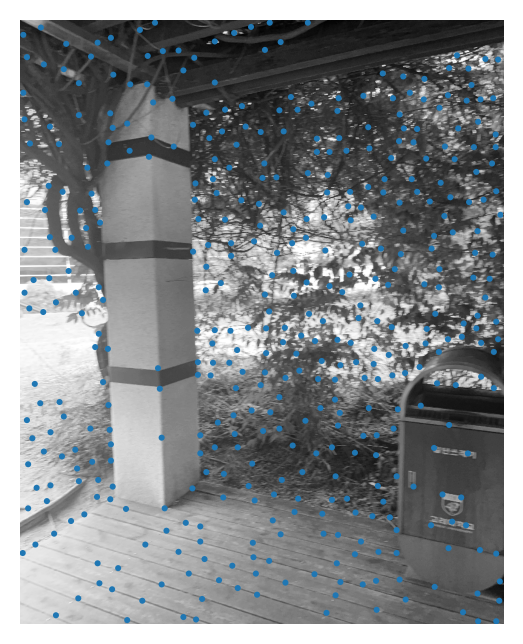

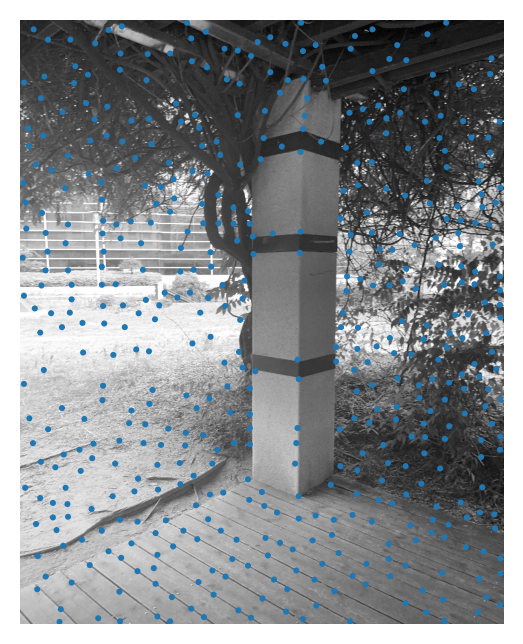

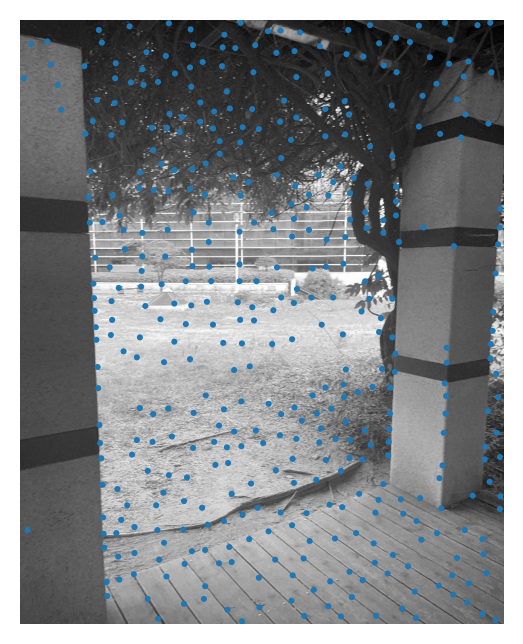

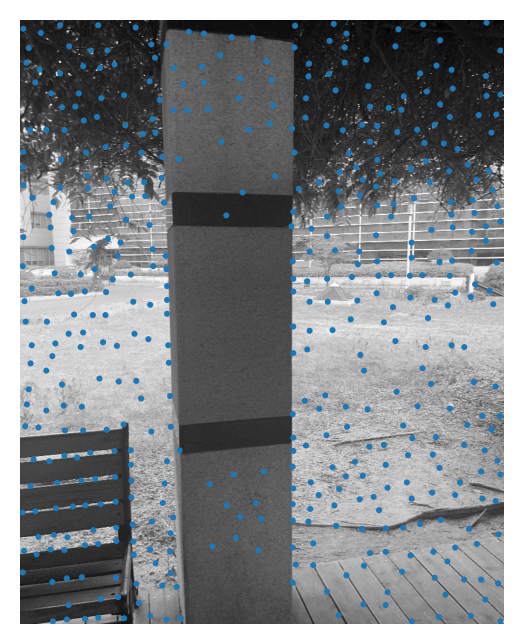

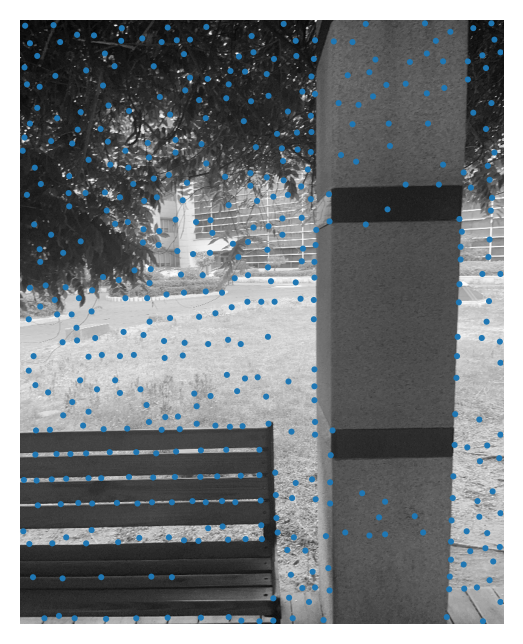

...

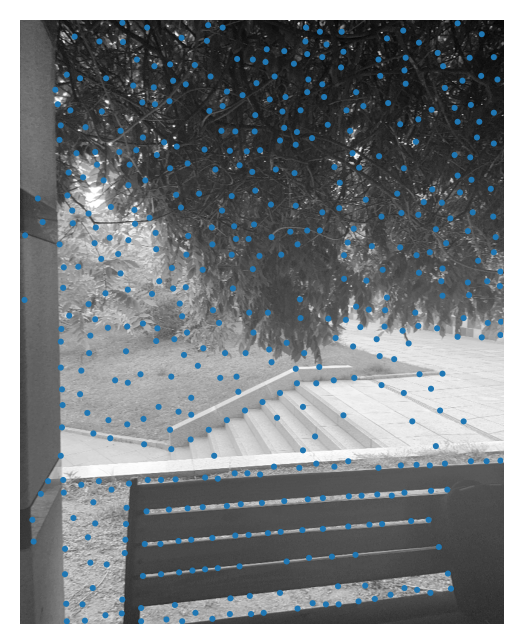

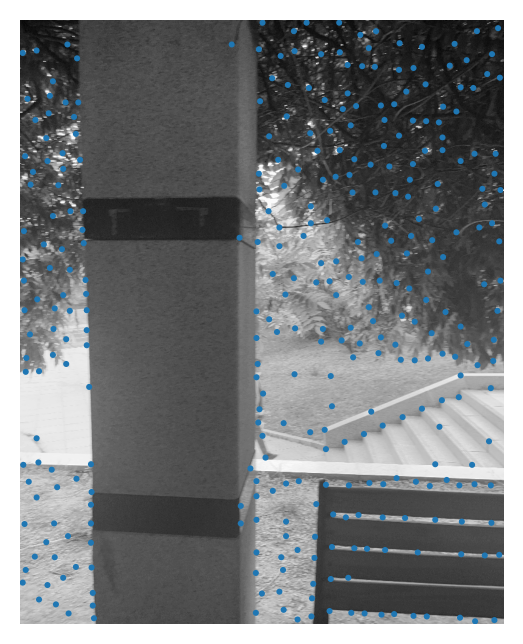

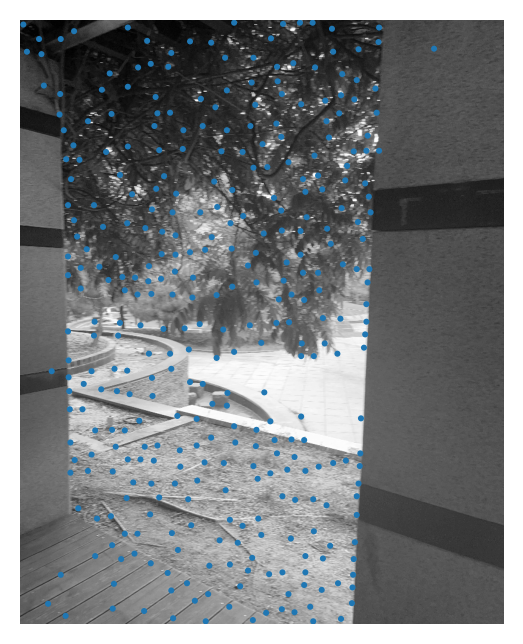

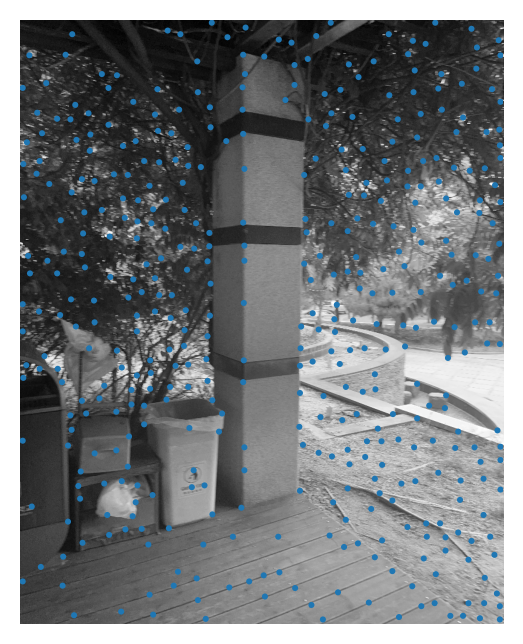

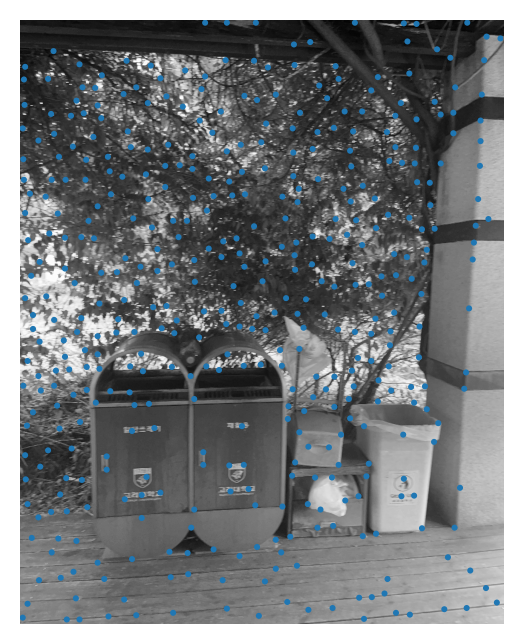

In [14]:
detected_corners = []

for i, img in enumerate(imgs):
    _, ax = plt.subplots(dpi=200)
    plt.axis("off")
    plt.imshow(img, cmap="gray")
    detected = getFeaturePoints(img)
    detected_corners.append(detected)
    
    # Draw corners
    for x,y in detected:
        ax.add_patch(
            mpl.patches.Circle(
                (y, x),                   # (x, y)
                5,
                fill=True,
        ))

    plt.show()

In [15]:
def getFeatureDescriptors(imgs, detected_corners, window_size=21):
    half_size = window_size // 2
    
    results = []
    for img, detected in zip(imgs, detected_corners):
        features = []
        img = np.pad(img, (half_size, half_size), mode="reflect")    # To address out range of image
        for y, x in detected:
            roi = img[y:y+window_size, x:x+window_size]    # because of the padding same as [y-half:y+half+1, x-half:x+half+1]
            
            feature = roi.reshape(-1)
            assert len(feature) == window_size ** 2, f"feature shape: {feature.shape}"
            features.append(feature)
        
        results.append(features)
    
    return results

In [16]:
features = getFeatureDescriptors(imgs, detected_corners)

print("Number of corners", [len(detected) for detected in detected_corners])
print("Number of features", [len(feature) for feature in features])
print("Feature dimension", features[0][0].shape)

Number of corners [429, 501, 423, 475, 454, 450, 421, 432, 477, 445, 440, 364, 387, 474, 335, 348, 436, 437]
Number of features [429, 501, 423, 475, 454, 450, 421, 432, 477, 445, 440, 364, 387, 474, 335, 348, 436, 437]
Feature dimension (441,)


In [17]:
def match2Images(imgs, corners, features, threshold, criterion="euclidian", plot=True):
    assert len(corners) == 2, f"Only support two images but length of corners is {len(corners)}"
    assert len(features) == 2, f"Only support two images but length of features is {len(features)}"
    assert criterion in ["euclidian", "correlation"], f"criterion supports only two types of 'euclidian', 'correlation' but given is {criterion}"
    
    # Based on small number of corners
    if len(features[0]) <= len(features[1]):
        features_A = np.stack(features[0])
        features_B = np.stack(features[1])
    else:
        features_A = np.stack(features[1])
        features_B = np.stack(features[0])

    # Get pairwise distance
    if criterion == "euclidian":
        # pairwise euclidian distance
        distance_matrix = ((features_A[:, np.newaxis, :] - features_B[np.newaxis, :, :]) ** 2).mean(axis=-1)    # [N, M]
    else:
        # pairwise normalized cross correlation
        # Normalize
        features_A = features_A / np.sqrt((features_A ** 2).sum(axis=-1, keepdims=True))
        features_B = features_B / np.sqrt((features_B ** 2).sum(axis=-1, keepdims=True))
        
        mean_A = features_A.mean(axis=-1, keepdims=True)
        mean_B = features_B.mean(axis=-1, keepdims=True)
        shifted_A = features_A - mean_A    # X - E(X)
        shifted_B = features_B - mean_B    # X - E(X)
        std_A = features_A.std(axis=-1)
        std_B = features_B.std(axis=-1)
        
        correlation_matrix = std_A[:, np.newaxis] * std_B[np.newaxis, :]    # [N, M]
        distance_matrix = (shifted_A[:, np.newaxis, :]  * shifted_B[np.newaxis, :, :]).mean(axis=-1) / correlation_matrix
    
    sorted_indices = np.argsort(distance_matrix, axis=-1)

    dummy_indices = np.arange(sorted_indices.shape[0])    # for selecting 1st, 2nd distance indices
    matched_indices = sorted_indices[:, 0]    # shortest distance
    second_indices = sorted_indices[:, 1]
    
    # non_maximum suppression for duplicated matches because we only consider shortest distance independently.
    nms_mask = np.zeros(sorted_indices.shape[0], dtype=np.bool) # for selecting indices after nms
    unique_indices = np.unique(matched_indices)
    for index in unique_indices:
        mask = matched_indices == index
        if mask.sum() == 1:
            nms_mask = np.logical_or(nms_mask, mask)
        else:
            distances = distance_matrix[dummy_indices[mask], matched_indices[mask]]
            max_index = np.argwhere(mask == 1)[np.argmax(distances)]
            nms_mask[max_index] = 1
    
    dummy_indices = dummy_indices[nms_mask]
    matched_indices = matched_indices[nms_mask]
    second_indices = second_indices[nms_mask]
    
    first_distance = distance_matrix[dummy_indices, matched_indices]    # 1st distance
    second_distance = distance_matrix[dummy_indices, second_indices]    # 2nd distance
    ratio_distance = first_distance / second_distance    # ratio distance

    ratio_mask = ratio_distance > threshold
    thresholded_indices = np.stack([dummy_indices[ratio_mask], matched_indices[ratio_mask]], axis=-1)
    
    if len(features[0]) > len(features[1]):
        # switch A, B
        thresholded_indices = np.stack([
            thresholded_indices[:, 1],
            thresholded_indices[:, 0],
        ], axis=-1)
    
    if plot:
        height, width = imgs[0].shape[:2]
        concat_imgs = np.concatenate(imgs, axis=1)
        
        _, ax = plt.subplots(dpi=200)
        
        plt.axis("off")
        plt.imshow(concat_imgs, cmap="gray")
        
        # Draw corners
        for i, j in thresholded_indices:
            y_i, x_i = corners[0][i]
            y_j, x_j = corners[1][j]
            ax.add_patch(
                mpl.patches.Circle(
                    (x_i, y_i),                   # (x, y)
                    5,
                    fill=True,
            ))
            ax.add_patch(
                mpl.patches.Circle(
                    (x_j + width, y_j),                   # (x, y)
                    5,
                    fill=True,
            ))
            ax.add_patch(
                mpl.patches.Arrow(
                    x_i, y_i,
                    x_j + width - x_i, y_j - y_i,
                    width=5,
                )
            )
    
    return thresholded_indices

/var/folders/qx/rhx45yq14q1f0zt5cwf7x8g80000gn/T/ipykernel_57354/1209340876.py:41: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  nms_mask = np.zeros(sorted_indices.shape[0], dtype=np.bool) # for selecting indices after nms


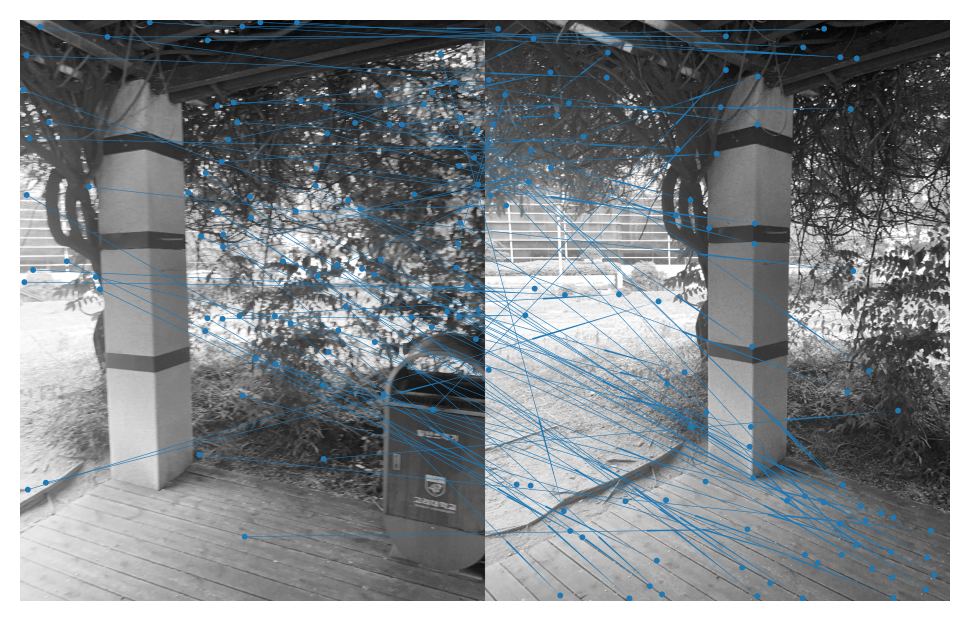

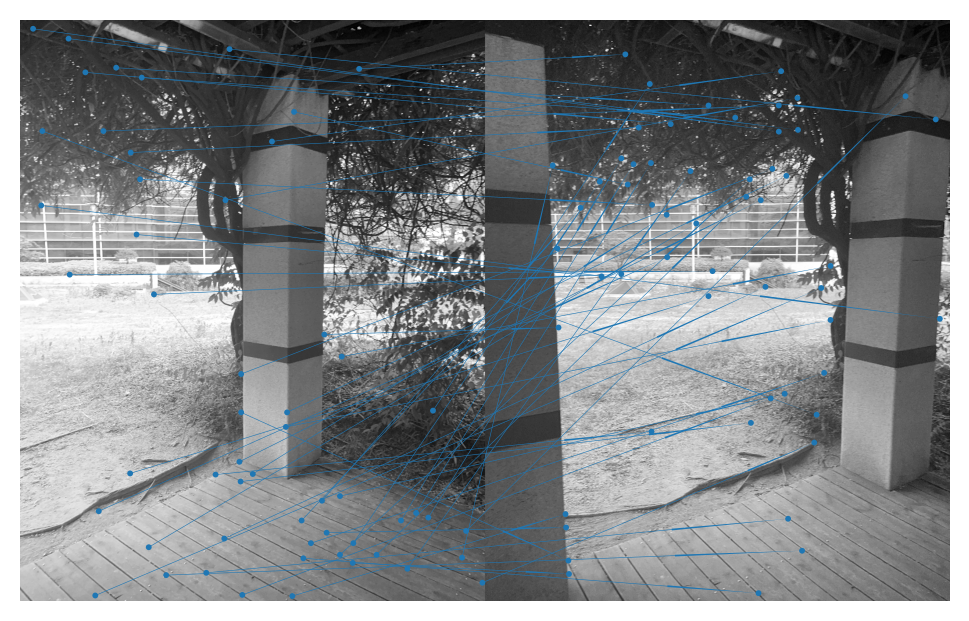

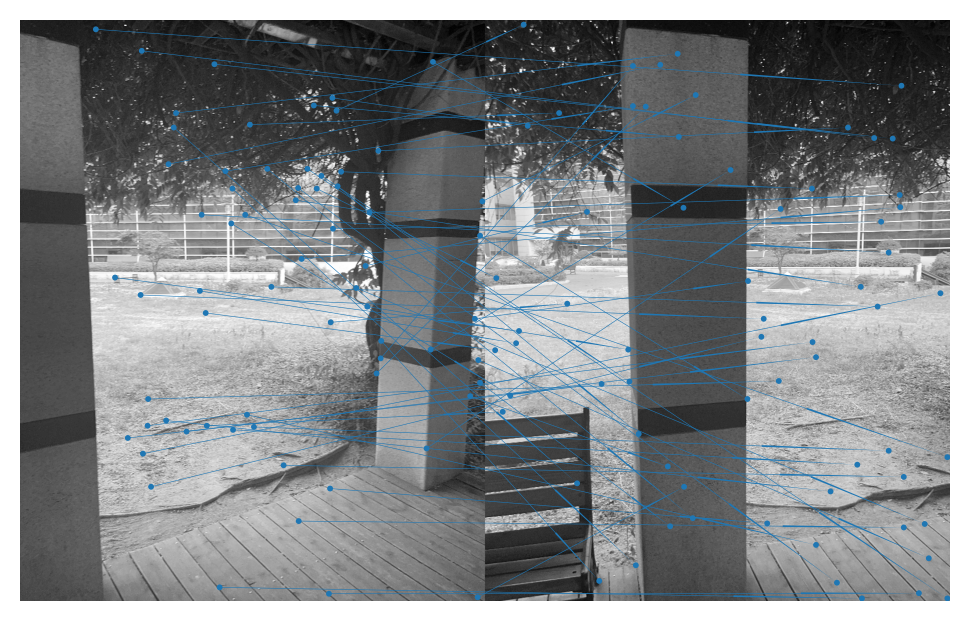

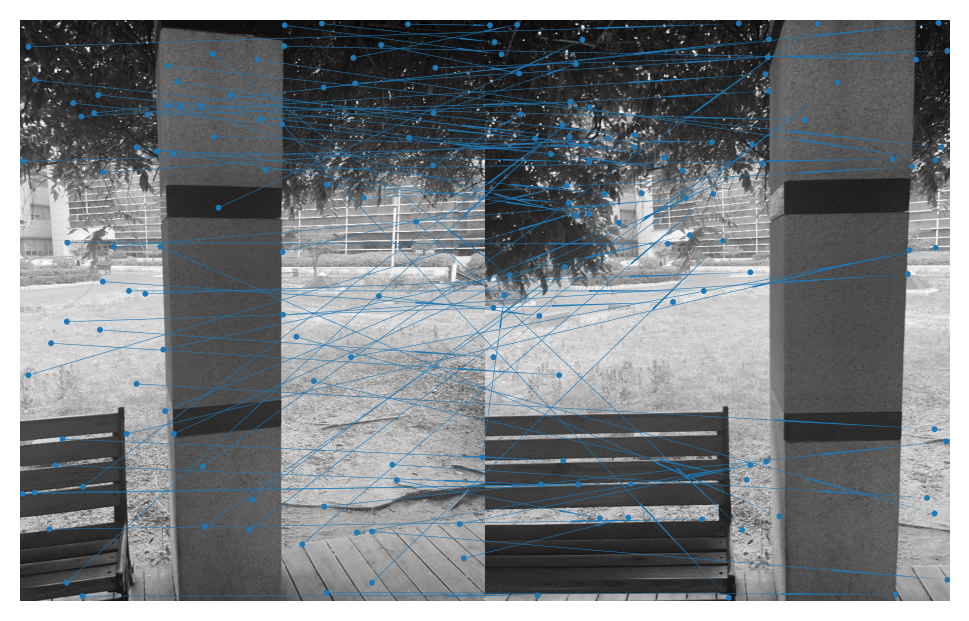

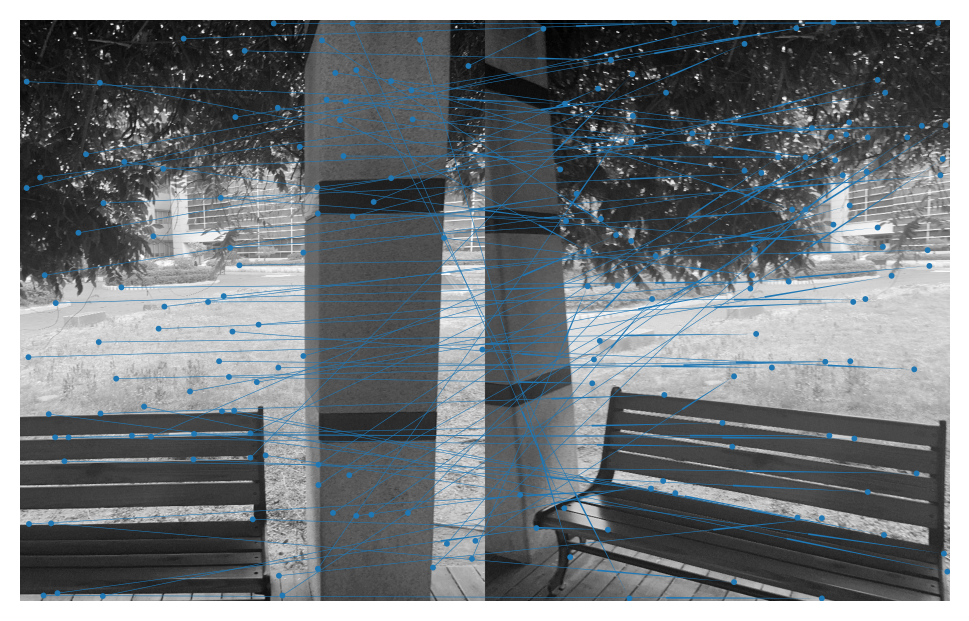

...

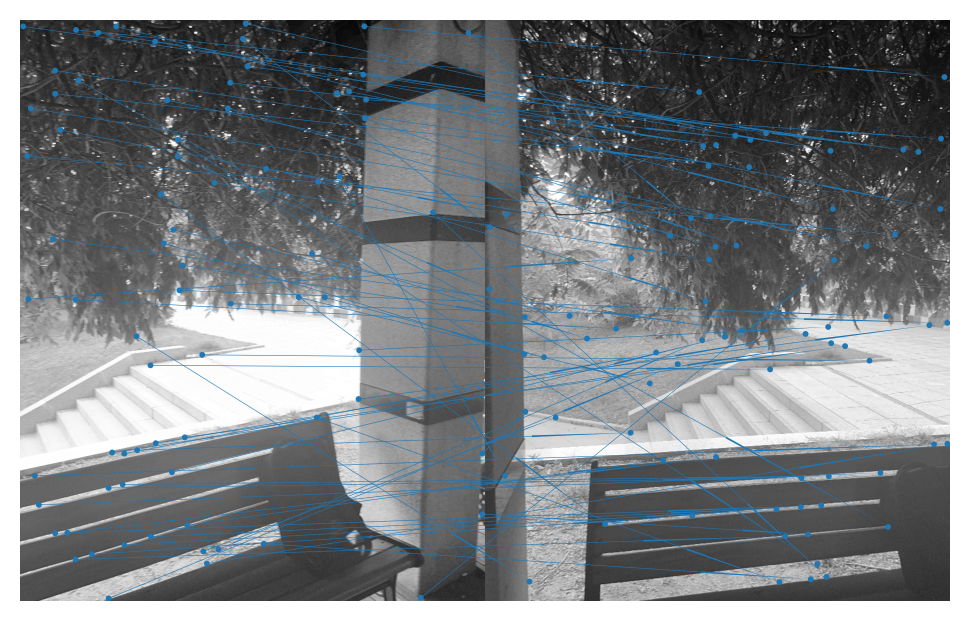

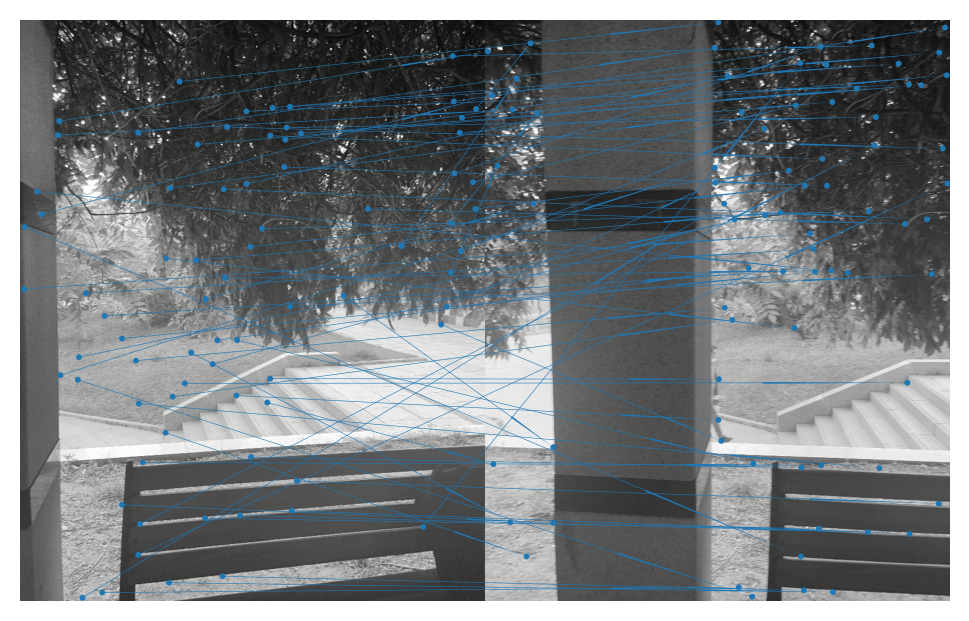

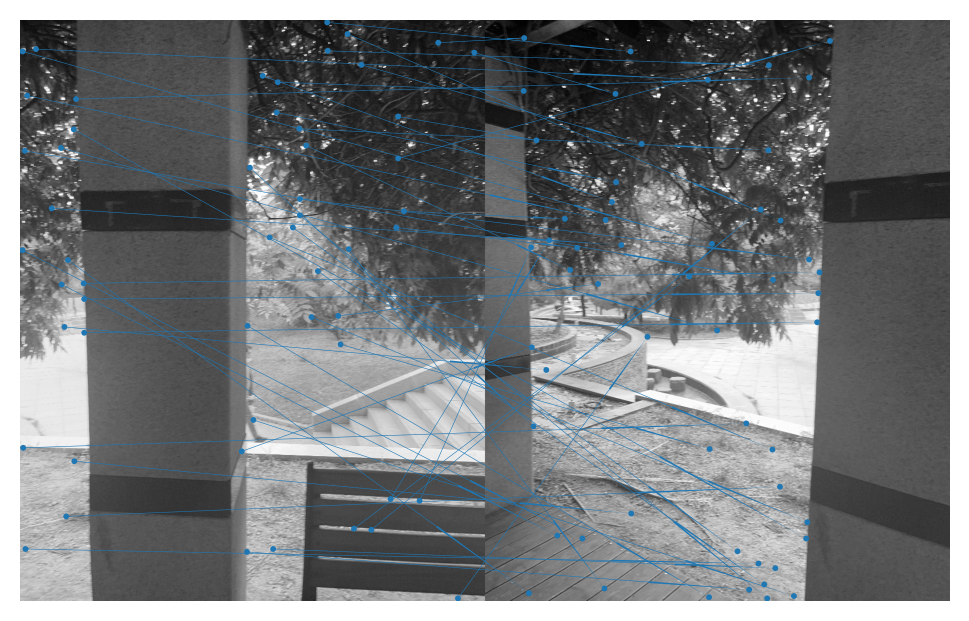

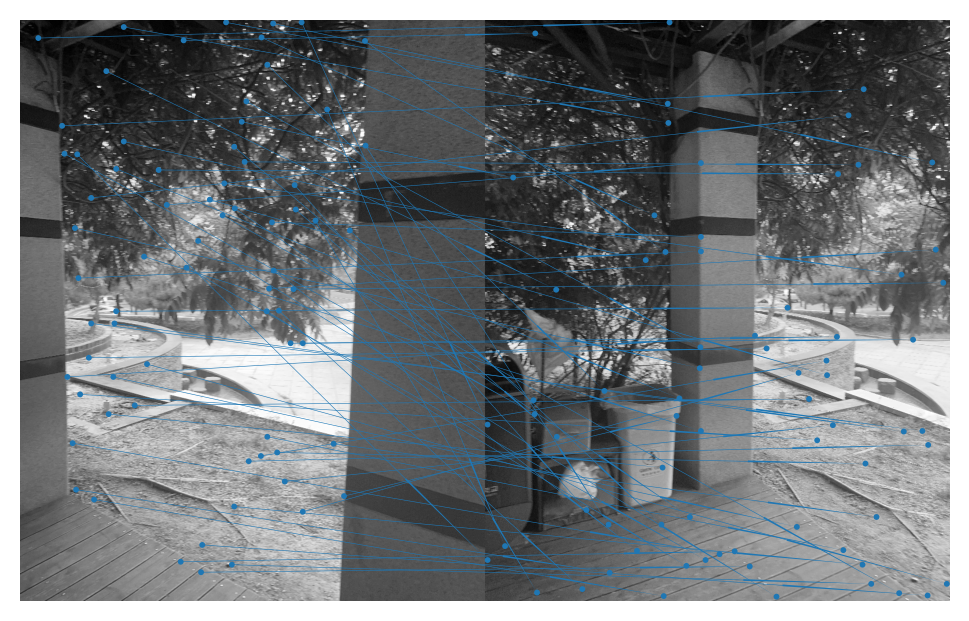

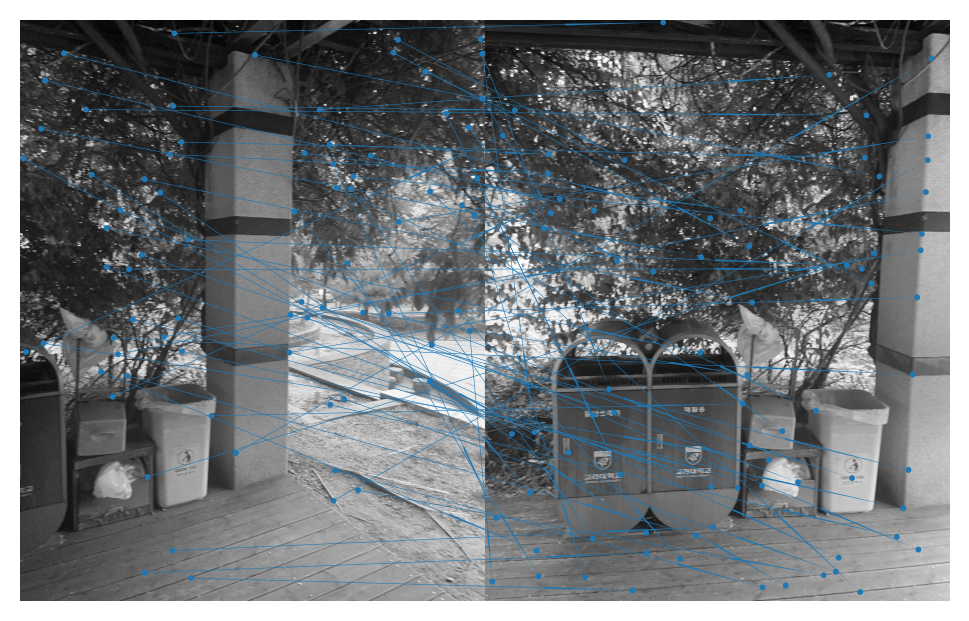

In [18]:
matched_indices = []
threshold = 0.95
for i in range(17):
    matched_indices.append(match2Images(imgs[i:i+2], detected_corners[i:i+2], features[i:i+2], threshold, criterion="euclidian"))

In [19]:
def refineMatches(imgs, corners, matched_indices, threshold, num_iter=10000, num_points=4, plot=True):
    inlier_indices = []
    result_homography = None
    
    corners_A = corners[0][matched_indices[:, 0]]
    corners_B = corners[1][matched_indices[:, 1]]
    for i in range(num_iter):
        random_indices = np.random.choice(np.arange(len(matched_indices)), num_points)
        
        random_corners_A = corners[0][matched_indices[random_indices][:, 0]]
        random_corners_B = corners[1][matched_indices[random_indices][:, 1]]
        
        # Compute homographies
        matrix = []
        for (y1, x1), (y2, x2) in zip(random_corners_A, random_corners_B):
            matrix.append([x1, y1, 1, 0,  0,  0, -x2 * x1, -x2 * y1, -x1])
            matrix.append([0,  0,  0, x1, y1, 1, -y2 * x1, -y2 * y1, -y1])
        matrix = np.stack(matrix)

        u, s, v = np.linalg.svd(matrix)    # Singular Value Decomposition (SVD)

        eigenvector = v[-1]
        h = np.reshape(eigenvector, (3, 3))
        h = h / h[2, 2]    # normalize
        
        # Compute distances of selected corners
        homo_corners_B = np.concatenate([corners_B, np.ones((len(corners_B), 1), dtype=corners[0].dtype)], axis=-1)    # homography coordinate
        transformed_corners_B = np.dot(h, homo_corners_B.T).T
        transformed_corners_B = transformed_corners_B / transformed_corners_B[:, [-1]]    # normalize
        transformed_corners_B = transformed_corners_B[:, :2]
        
        distances = np.sqrt((transformed_corners_B - corners_A) ** 2).sum(axis=-1)
        
        inliers = matched_indices[distances < max(img.shape[0], img.shape[1]) * threshold]
        if len(inliers) > len(inlier_indices):
            inlier_indices = inliers
            result_homography = h
    
    if plot:
        height, width = imgs[0].shape[:2]
        concat_imgs = np.concatenate(imgs, axis=1)
        
        _, ax = plt.subplots(dpi=200)
        
        plt.axis("off")
        plt.imshow(concat_imgs, cmap="gray")
        
        # Draw corners
        for i, j in inlier_indices:
            y_i, x_i = corners[0][i]
            y_j, x_j = corners[1][j]
            ax.add_patch(
                mpl.patches.Circle(
                    (x_i, y_i),                   # (x, y)
                    5,
                    fill=True,
            ))
            ax.add_patch(
                mpl.patches.Circle(
                    (x_j + width, y_j),                   # (x, y)
                    5,
                    fill=True,
            ))
            ax.add_patch(
                mpl.patches.Arrow(
                    x_i, y_i,
                    x_j + width - x_i, y_j - y_i,
                    width=5,
                )
            )
    
    return result_homography

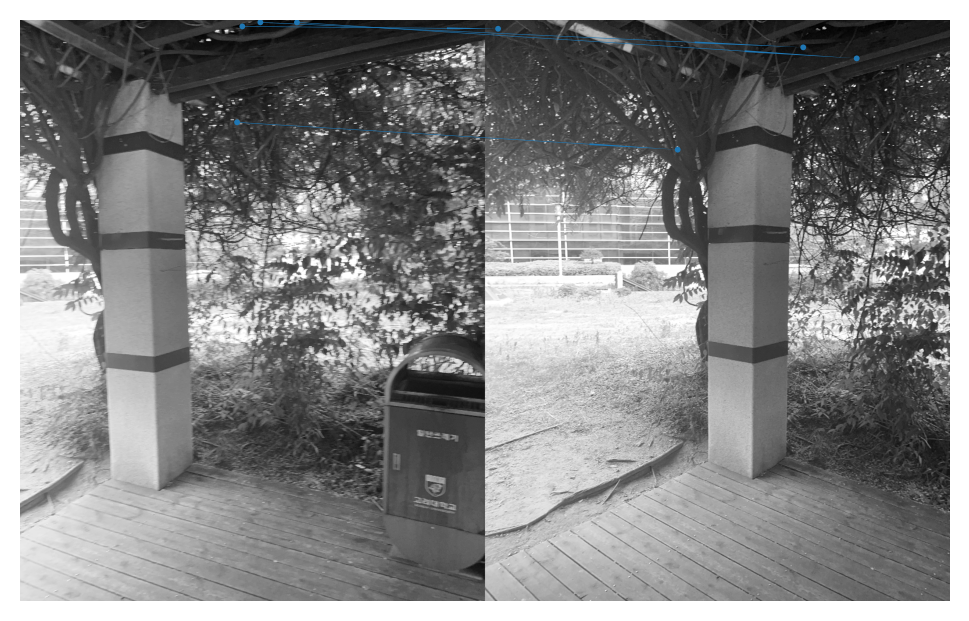

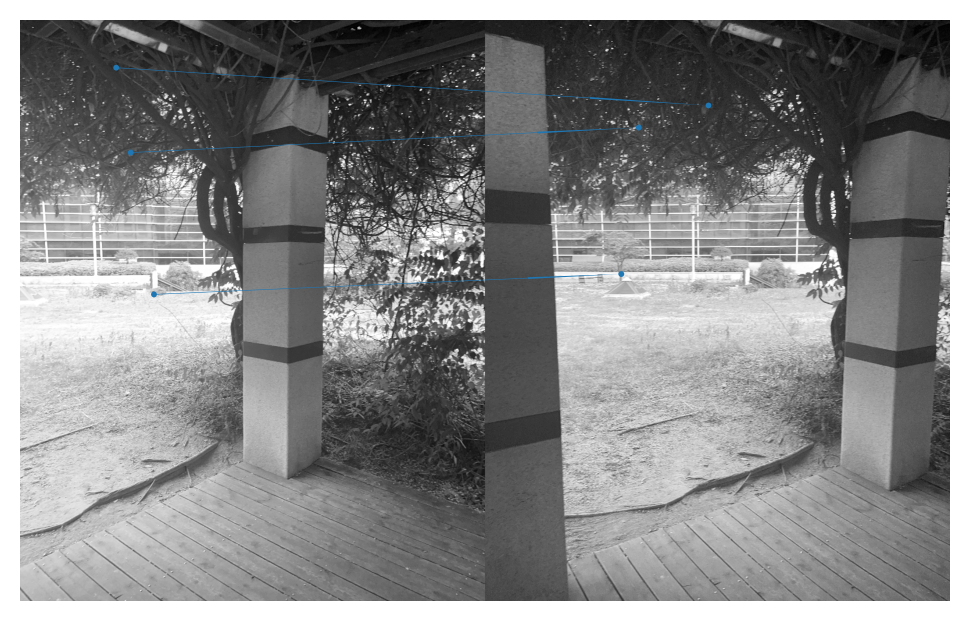

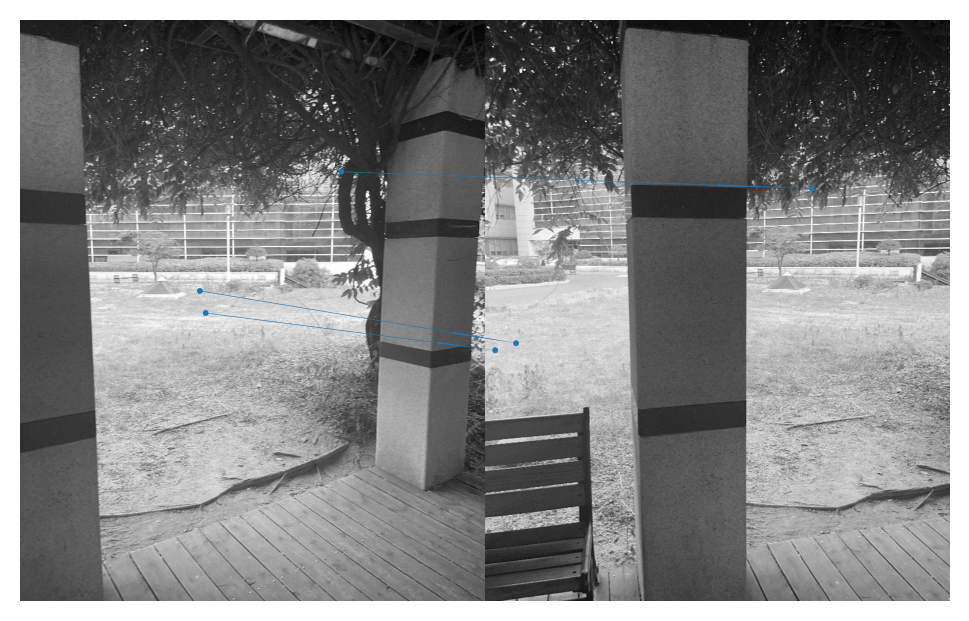

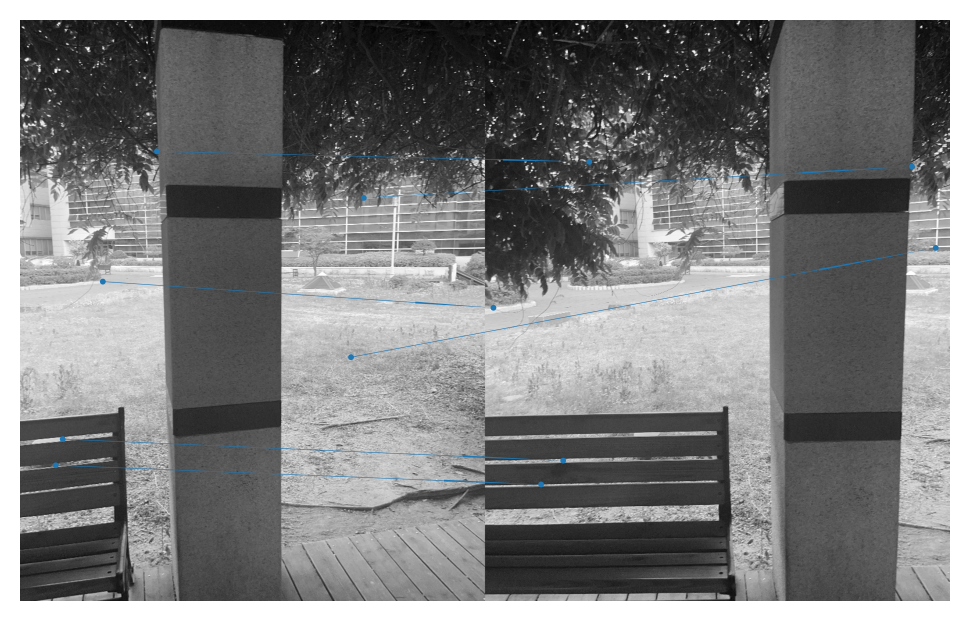

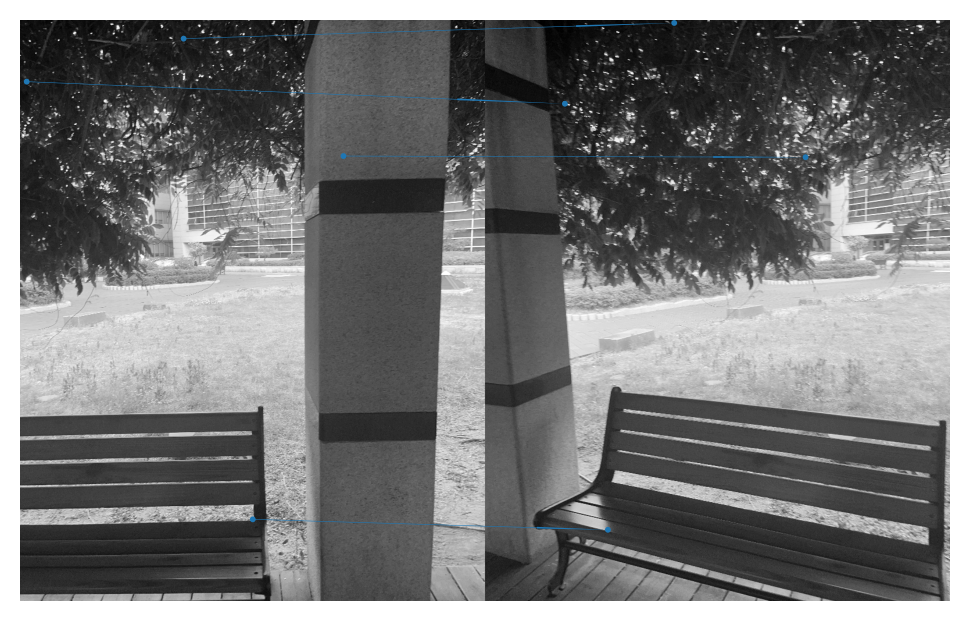

...

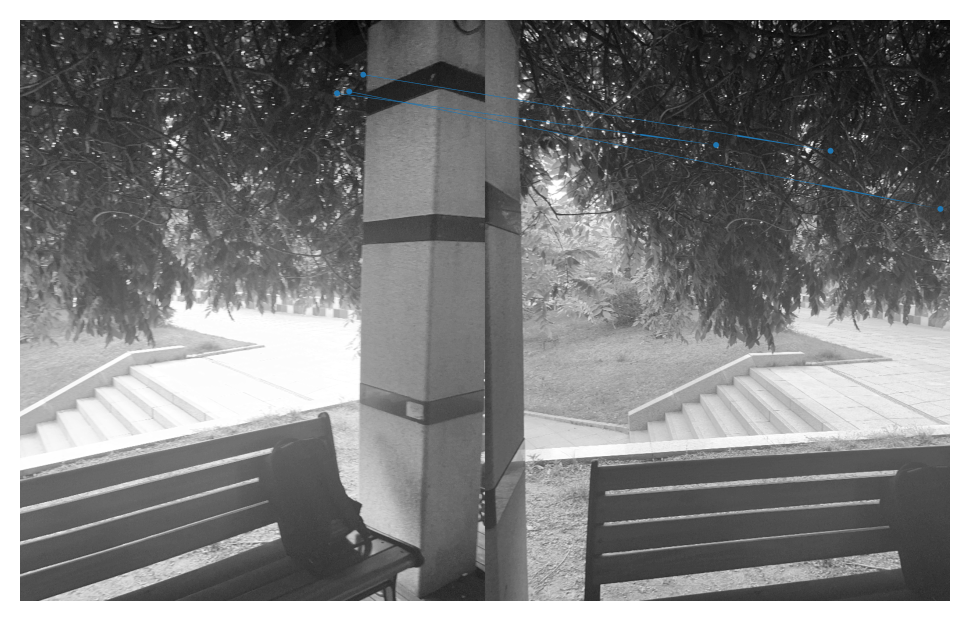

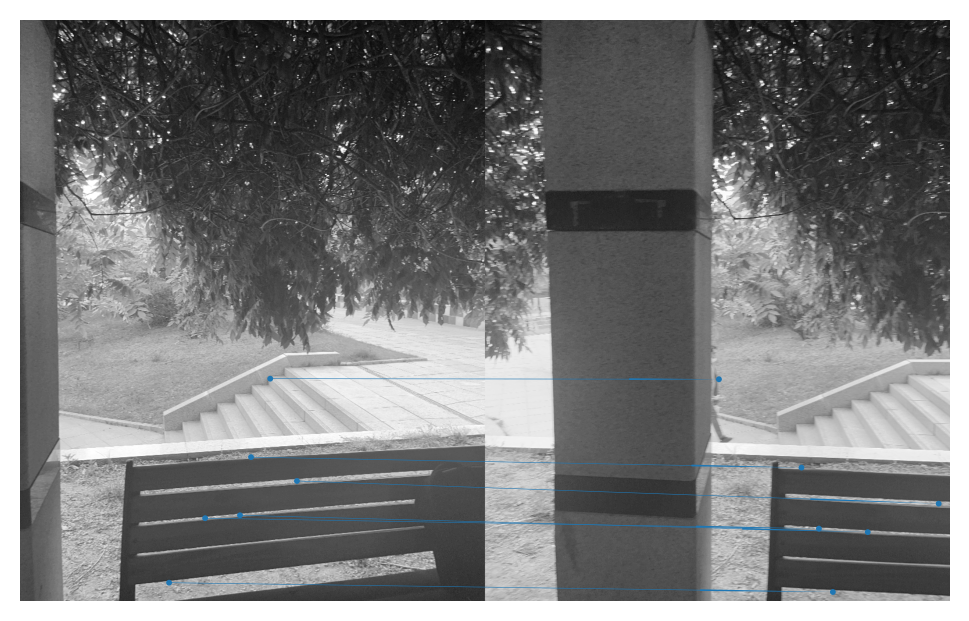

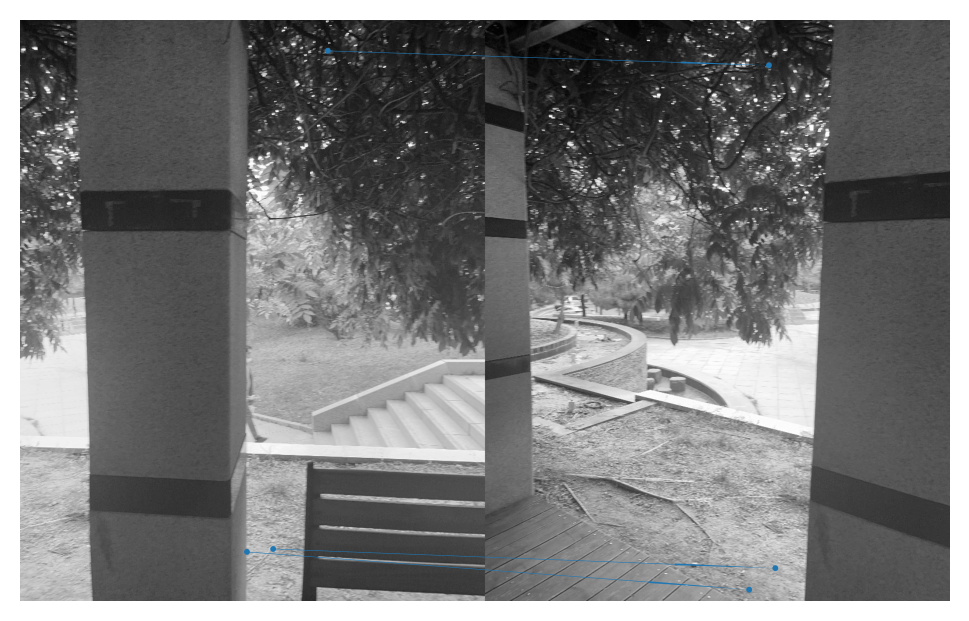

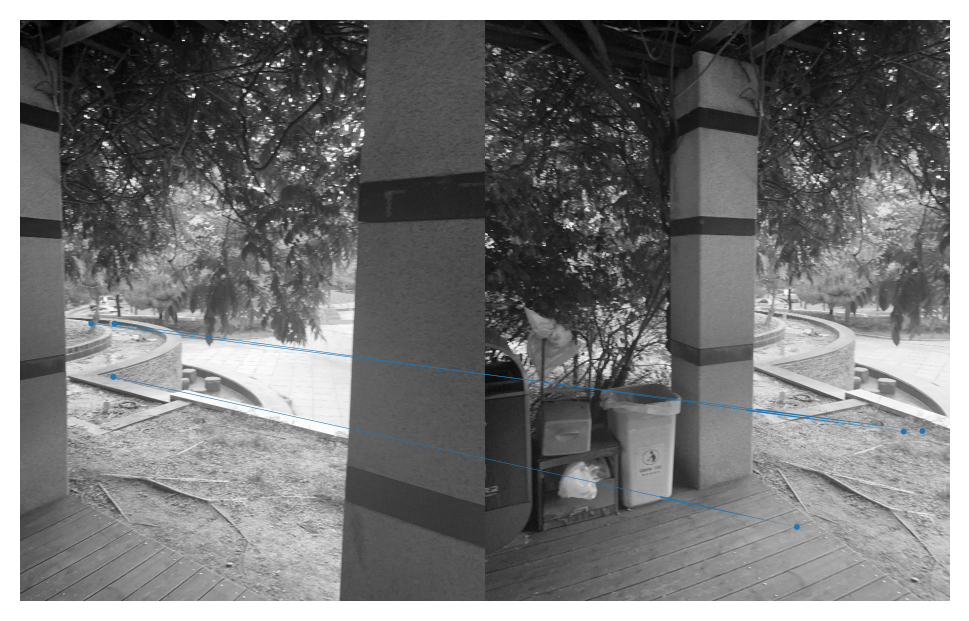

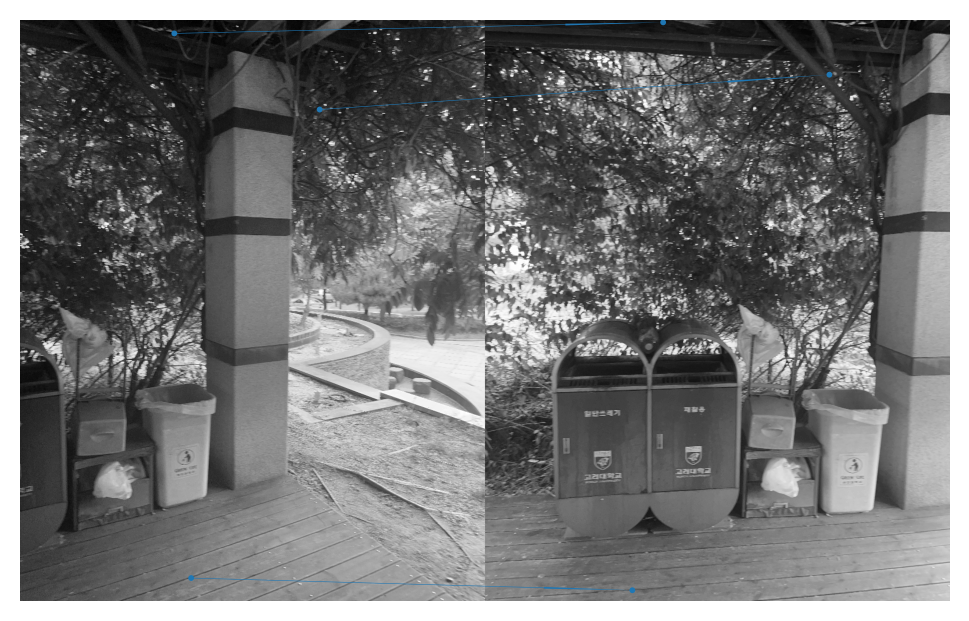

In [20]:
homographies = []
for i in range(17):
    homographies.append(refineMatches(imgs[i:i+2], detected_corners[i:i+2], matched_indices[i], 0.05))

In [21]:
def warpImages(imgs, homographies):
    result_image = []
    for i in range(len(imgs) - 1):
        homography = homographies[i]
        for j in range(i + 1, len(imgs) - 1):
            homography = np.dot(homographies[j], homography)
        # transfomed_img = cv2.warpPerspective(imgs[i], homography, (imgs[i].shape[1], imgs[i].shape[0]))
        # transfomed_img = cv2.warpPerspective(imgs[i], homographies[i], (imgs[i].shape[1], imgs[i].shape[0]))
        result = cv2.warpPerspective(imgs[i+1], homographies[i],
            (imgs[i].shape[1] + imgs[i+1].shape[1], imgs[i].shape[0]))
        result[0:imgs[i+1].shape[0], 0:imgs[i+1].shape[1]] = imgs[i]

        # print(transfomed_img.shape, imgs[i].shape)
        # plt.imshow(transfomed_img, cmap="gray")
        # plt.imshow(np.concatenate((imgs[i], transfomed_img, imgs[i+1]), axis=1), cmap="gray")
        plt.imshow(result, cmap="gray")
        plt.show()

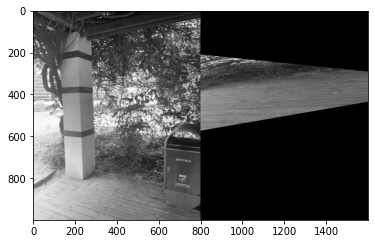

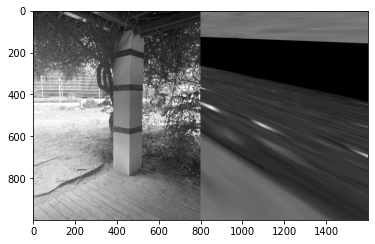

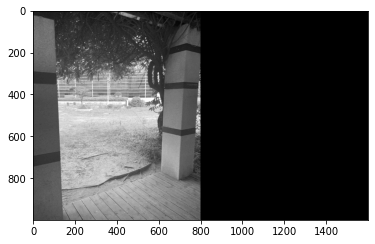

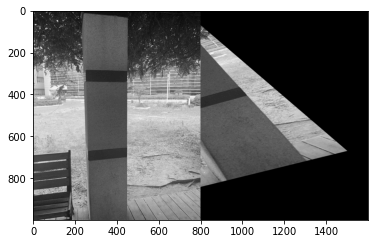

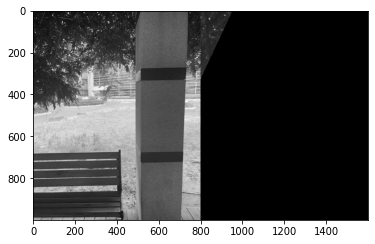

...

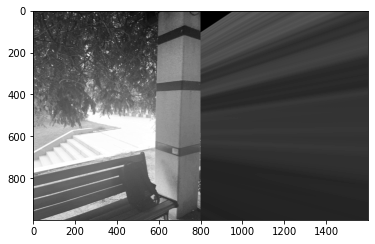

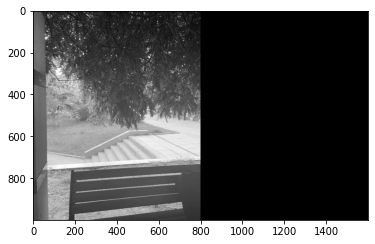

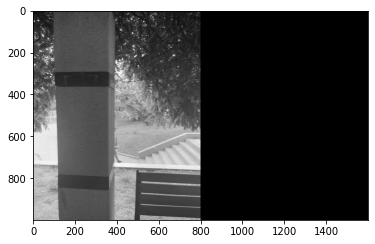

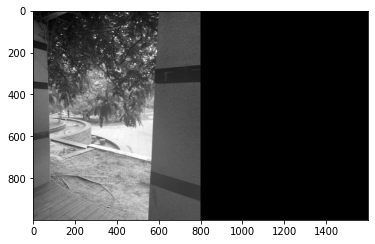

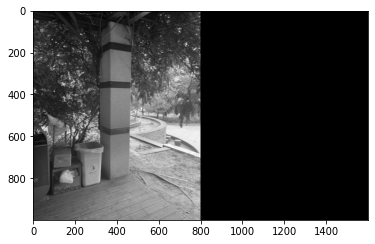

In [22]:
warpImages(imgs, homographies)